<img src="img/Insurance.jpg" width="1600" height="450"/>
<h1>Insurance Case</h1>



Source: https://afia.ae/blog/car-insurance/how-to-estimate-the-cost-of-car-insurance-in-dubai/ / https://taxguru.in/income-tax/5-benefits-health-insurance.html

# 1.0 Background

## The Insurance All

Insurance All is a company that provides health insurance to its customers and the product team is analyzing the possibility of offering policyholders a new product: auto insurance.

As with health insurance, customers of this new auto insurance plan need to pay an amount annually to Insurance All to obtain an amount insured by the company, aimed at the costs of an eventual accident or damage to the vehicle.

Insurance All conducted a survey of about 380,000 customers about their interest in joining a new auto insurance product last year. All customers expressed interest or not in purchasing auto insurance and these responses were saved in a database along with other customer attributes.

The product team selected 127 thousand new customers who did not respond to the survey to participate in a campaign, in which they will receive the offer of the new auto insurance product. The offer will be made by the sales team through telephone calls.

However, the sales team has the capacity to make 20 thousand calls within the campaign period.

## The challenge

In that context, you were hired as a Data Science consultant to build a model that predicts whether or not the customer would be interested in auto insurance.

With its solution, the sales team hopes to be able to prioritize the people with the greatest interest in the new product and, thus, optimize the campaign by making only contacts with customers most likely to make the purchase.

As a result of your consultancy, you will need to deliver a report containing some analysis and answers to the following questions:

- Main insights on the most relevant attributes of customers interested in purchasing auto insurance.
- What percentage of customers interested in purchasing auto insurance will the sales team be able to reach by making 20,000 calls?
- And if the sales team's capacity increases to 40,000 calls, what percentage of customers interested in purchasing auto insurance will the sales team be able to contact?
- How many calls does the sales team need to make to contact 80% of customers interested in purchasing auto insurance?

# 2.0 Importing libraries

In [48]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt 
import seaborn as sns
import missingno as msno
from scipy import stats

from IPython.core.display import HTML 

# disable max columns limit
pd.set_option('display.max_columns', 70)


# Disabling warnings
import warnings
warnings.filterwarnings('ignore')

%matplotlib inline

In [49]:
def jupyter_settings():
    %matplotlib inline
    %pylab inline
    
    sns.set(font_scale=1.6)
    
    #plt.style.use("fivethirtyeight")
    #sns.set(style='whitegrid')
    plt.style.use('seaborn-darkgrid')
    plt.rcParams['figure.figsize'] = [25, 12]
    plt.rcParams['font.size'] = 16
    
    display( HTML('<style>.container {width:100% !important; }</style>'))
    pd.options.display.max_columns = None
    pd.options.display.max_rows = None
    pd.set_option('display.expand_frame_repr', False)
    
jupyter_settings()

Populating the interactive namespace from numpy and matplotlib


In [50]:
def boxplot(df,x,y,x_text=None,y_text=None,title=None, x_lim=None, y_lim=None, palette=None):

  ax = sns.boxplot(x=x, y=y, data=df, palette=palette)
  ax.set_xlabel(x_text, fontsize=16)
  ax.set_ylabel(y_text, fontsize=16)
  ax.set_xlim(x_lim)
  ax.set_ylim(y_lim)
  plt.title(title, fontsize=18)

In [51]:
train = pd.read_csv('train.csv')

# 3.0 Descriptive Data Analysis


| Feature                                       | Type                |                                       Feature Name                                          | Data Type                                        |
|:----------------------------------------------|:--------------------|:--------------------------------------------------------------------------------------------|:-------------------------------------------------|
| id                                            | Objective Feature   | Unique id for the customer                                                                  | int64                                            |
| Gender                                        | Objective Feature   | Gender of the customer                                                                      | object                                           |
| Age                                           | Objective Feature   | Age of the customer                                                                         | int64                                            |
| Driving_License                               | Objective Feature   | 0: Customer does not have DL, 1: Customer already has DL                                    | int64                                            |
| Region_Code                                   | Objective Feature   | Unique code for the region of the customer                                                  | int64                                            |
| Previous_Insured                              | Objective Feature   | 1 : Customer already has Vehicle Insurance, 0 : Customer doesn't have Vehicle Insurance     | int64                                            |
| Vehicle_Age                                   | Objective Feature   | Age of the vehicle                                                                          | int64                                            |





In [52]:
train.shape

(381109, 12)

In [53]:
train.describe()

,Id,Age,Driving_License,Region_Code,Previously_Insured,Annual_Premium,Policy_Sales_Channel,Vintage,Response
count,381109.000000,381109.000000,381109.000000,381109.000000,381109.000000,381109.000000,381109.000000,381109.000000,381109.000000
mean,190555.000000,38.822584,0.997869,26.388807,0.458210,30564.389581,112.034295,154.347397,0.122563
std,110016.836208,15.511611,0.046110,13.229888,0.498251,17213.155057,54.203995,83.671304,0.327936
min,1.000000,20.000000,0.000000,0.000000,0.000000,2630.000000,1.000000,10.000000,0.000000
25%,95278.000000,25.000000,1.000000,15.000000,0.000000,24405.000000,29.000000,82.000000,0.000000
50%,190555.000000,36.000000,1.000000,28.000000,0.000000,31669.000000,133.000000,154.000000,0.000000
75%,285832.000000,49.000000,1.000000,35.000000,1.000000,39400.000000,152.000000,227.000000,0.000000
max,381109.000000,85.000000,1.000000,52.000000,1.000000,540165.000000,163.000000,299.000000,1.000000


There is no null values in this dataset


<Figure size 432x288 with 0 Axes>

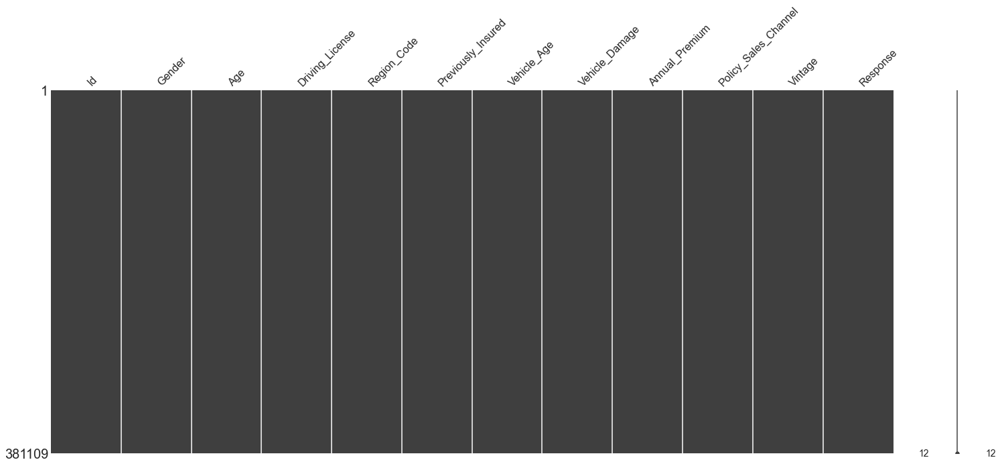

In [54]:
print('There is no null values in this dataset')

plt.figure(figsize=(6,4))
msno.matrix(train)
plt.show()

### Age

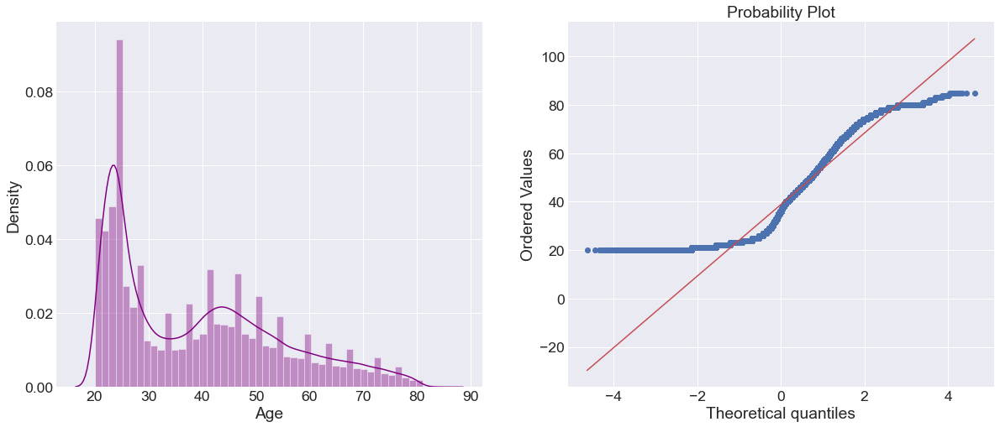

In [55]:
# sets the figure size in inches
plt.figure(figsize=(20,8))

plt.subplot(1,2,1)
sns.distplot(train['Age'], color="purple")


plt.subplot(1,2,2)
# Probability plot
stats.probplot(train['Age'], plot=plt)

plt.show()

In [56]:
train.columns

Index(['Id', 'Gender', 'Age', 'Driving_License', 'Region_Code',
       'Previously_Insured', 'Vehicle_Age', 'Vehicle_Damage', 'Annual_Premium',
       'Policy_Sales_Channel', 'Vintage', 'Response'],
      dtype='object')

## Short explanation of the input variables

- **id:** This is the id of the customers.
- **gender:** Gender of the customers.
- **age:** This is the age of the customers.
- **region_code:** Code related to the region where the customer is located (53 places).
- **policy_sales_channel:** Anonymized code that refers to the channel used to contact the customer.
- **driving_license:** The customer has or does not have DL.
- **vehicle_age:** Age of the vehicle.
- **vehicle_damage:** Damage of the vehicle.
- **previously_insured:** Customer already has vehicle insurance or not.
- **annual_premium:** The amount customer needs to pay as premium in the year.
- **vintage:** Number of days the customer has been associated with the company.
- **response:** Target variable. The customer is interested or not.

## Distribution of the output variable

In [57]:
train['Response'].value_counts()

0    334399
1     46710
Name: Response, dtype: int64

In [58]:
total_accepted = round((train[train['Response']==1].shape[0]/train.shape[0])*100, 2)
total_not_accepted = round((100-total_accepted), 2)

print("The proportion of the output variable is {}/{}".format(total_accepted,total_not_accepted))
print("The output variable is unbalanced")

The proportion of the output variable is 12.26/87.74
The output variable is unbalanced


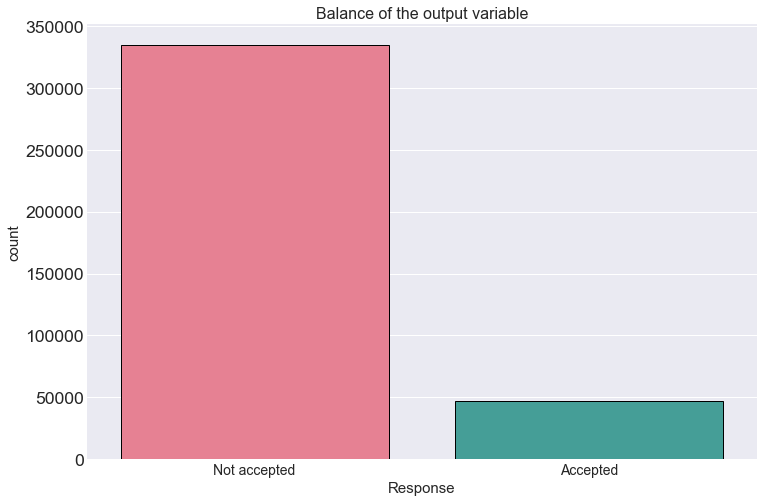

In [59]:
plt.figure(figsize=(12,8))

sns.countplot(x="Response", data = train, palette ="husl" ,edgecolor="black")
plt.ylabel('count', fontsize=15)
plt.xlabel('Response', fontsize=15)
plt.xticks(ticks=[0,1], labels=['Not accepted', 'Accepted'], fontsize=14)
plt.title('Balance of the output variable', fontsize=16)
plt.show()

___

## 4.0 Feature Engineering

### - Age range

In [60]:
train['age_range'] = train['Age'].apply(lambda x: 'Adult 1' if 20<x<30 else('Adult 2' if 30 < x < 40 else('Adult 3' if 40<x<65 else 'Elderly')))

### - Monthly premium

In [61]:
train['monthly_premium'] = round(train['Annual_Premium']/12, 2)

### - Percentage of total premium

In [62]:
train['percentage_total_premium'] = train['Annual_Premium']/train['Annual_Premium'].sum()

In [63]:
df = pd.get_dummies(train['Vehicle_Damage'], prefix='Vehicle_Damage').rename(columns={'vehicle_damage_0':'vehicle_damage_no', 'vehicle_damage_1':'vehicle_damage_yes'})

In [64]:
train  = pd.concat([train, df], axis=1)

In [65]:
train['insured_with_no_damage'] = train['Previously_Insured']*train['Vehicle_Damage_No']

In [66]:
train["not_insured_with_damage"] = train["Previously_Insured"].apply(lambda x: 1 if x == 0 else 0) * train["Vehicle_Damage_Yes"]

In [67]:
train["vehicle_age_<_1_year"] = train["Vehicle_Age"].apply(lambda x: 1 if x=='< 1 Year' else 0)

In [68]:
train["new_damage_no_insurance"] = train["vehicle_age_<_1_year"]*train["not_insured_with_damage"]

In [69]:
train.head(10)

,Id,Gender,Age,Driving_License,Region_Code,Previously_Insured,Vehicle_Age,Vehicle_Damage,Annual_Premium,Policy_Sales_Channel,Vintage,Response,age_range,monthly_premium,percentage_total_premium,Vehicle_Damage_No,Vehicle_Damage_Yes,insured_with_no_damage,not_insured_with_damage,vehicle_age_<_1_year,new_damage_no_insurance
0,1,Male,44,1,28.0,0,> 2 Years,Yes,40454.0,26.0,217,1,Adult 3,3371.17,3.472934e-06,0,1,0,1,0,0
1,2,Male,76,1,3.0,0,1-2 Year,No,33536.0,26.0,183,0,Elderly,2794.67,2.879031e-06,1,0,0,0,0,0
2,3,Male,47,1,28.0,0,> 2 Years,Yes,38294.0,26.0,27,1,Adult 3,3191.17,3.287500e-06,0,1,0,1,0,0
3,4,Male,21,1,11.0,1,< 1 Year,No,28619.0,152.0,203,0,Adult 1,2384.92,2.456912e-06,1,0,1,0,1,0
4,5,Female,29,1,41.0,1,< 1 Year,No,27496.0,152.0,39,0,Adult 1,2291.33,2.360503e-06,1,0,1,0,1,0
5,6,Female,24,1,33.0,0,< 1 Year,Yes,2630.0,160.0,176,0,Adult 1,219.17,2.257828e-07,0,1,0,1,1,1
6,7,Male,23,1,11.0,0,< 1 Year,Yes,23367.0,152.0,249,0,Adult 1,1947.25,2.006033e-06,0,1,0,1,1,1
7,8,Female,56,1,28.0,0,1-2 Year,Yes,32031.0,26.0,72,1,Adult 3,2669.25,2.749828e-06,0,1,0,1,0,0
8,9,Female,24,1,3.0,1,< 1 Year,No,27619.0,152.0,28,0,Adult 1,2301.58,2.371063e-06,1,0,1,0,1,0
9,10,Female,32,1,6.0,1,< 1 Year,No,28771.0,152.0,80,0,Adult 2,2397.58,2.469961e-06,1,0,1,0,1,0


### How Insurance Companies Work

- Insurance companies assess the risk and charge premiums for various types of insurance coverage. If an insured event occurs and you suffer damages, the insurance company pays you up to the agreed amount of the insurance policy. The way insurance companies work, they can pay this and still make a profit.

Evaluating Risk

- Companies that buy insurance policies transfer their risk to the insurance company in return for paying their premiums. The insurance company has to define insurance risk it is taking on. It asks questions, each of which is designed to evaluate a particular risk. Depending on your answers to the questions, the insurance company quotes you a premium. If your risk is higher than usual – for example, if you are not near a fire hydrant, then your fire insurance will be higher. If you don't answer the questions honestly, the insurance company may refuse to pay if there are damages, according to the Insurance Institute of Michigan.

Shared Risk

- Your premiums are much lower than the possible damages, but the insurance company can afford to pay them because it receives premiums from many customers. Insurance companies operate on the principle of shared risk. All the customers pay small amounts and share the risk that way. A fire or other covered event only happens rarely. The insurance company has to calculate the premiums so the total premiums it receives from its many customers cover the few damage claims, with some money left over for administration and profit.


Re-Insurance

- Insurance companies have to consider that, if they have a lot of policies in one area and there is a natural disaster, many customers will make a claim. The insurance company may not have collected enough premiums to cover so many claims. To prevent such a problem, insurance companies pass on some of the risk to other large financial firms that offer re-insurance, meaning they may be protected in a worst case scenario.
The large firms take over the extra risk from the insurance company that holds the policies, and it pays for this service. For major natural disasters, the re-insurance companies pay for some of the damages through the local insurance companies that sold the policies.

Investment Income

- Over time, insurance companies receive lots of small amounts in premiums and have to occasionally pay out large amounts. Before paying out the damages, they may have large surpluses which they invest, according to Obrella. Because they don't want to take much additional risk, they typically place this money in safe investments, but it still generates a substantial income. This income increases the revenue of the insurance companies, and they can use it to reduce the premiums they charge or to increase their profits.

Source: https://smallbusiness.chron.com/insurance-companies-work-60269.html

## 5.0 EDA

## Hypothesis list

- **H1**: The men are more likely to accept insurance car
- **H2**: The region codes have similar amount of insurance acceptance
- **H3**: People with the highest annual premium values tend to accept new insurance (monthly income and more expensive goods)
- **H4**: Young people tend to accept the car insurance due to their age 
- **H5**: Only people with driver's license accept car insurance
- **H6**: People with newer cars are more likely to accept car insurance
- **H7**: The customers with the highest vintage values tend to accept the car insurance
- **H8**: Customers with the highest percent of total premium tend to increase this value, which means, they will accept the car insurance 
- **H9**: Customers with some damage in their cars tend to accept the car insurance
- **H10**: Customers with no damage in their cars tend to not accept the car insurance
- **H11**: If the people have a new car with damage and no insurance, they probably should get insurance
- **H12**: If the customer has insurance and no damage in his car, then the customer tends to not accept the insurance

# H1

H1: The men are more likely to accept insurance car --> FALSE


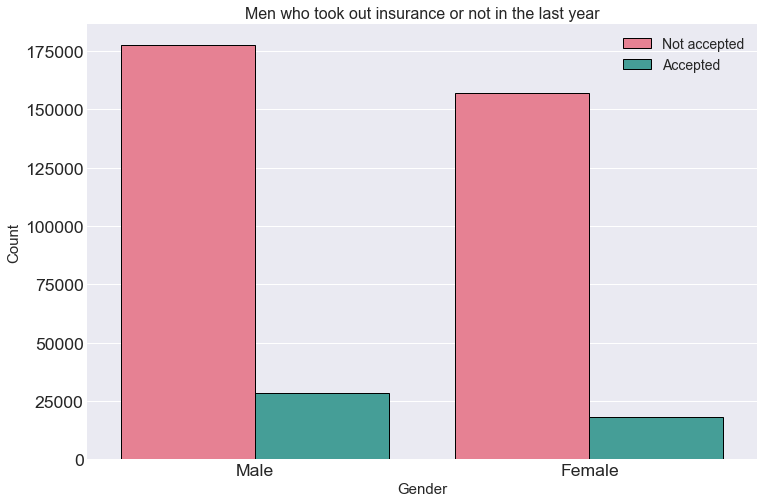

In [70]:
print("H1: The men are more likely to accept insurance car --> FALSE")
plt.figure(figsize=(12,8))

sns.countplot(x="Gender", hue='Response', data = train,palette ="husl" ,edgecolor="black")
plt.legend(['Not accepted', 'Accepted'], fontsize=14)
plt.ylabel('Count', fontsize=15)
plt.xlabel('Gender', fontsize=15)
plt.title('Men who took out insurance or not in the last year', fontsize=16)
plt.show()

___

# H2

H2: The region codes have similar amount of insurance acceptance --> FALSE


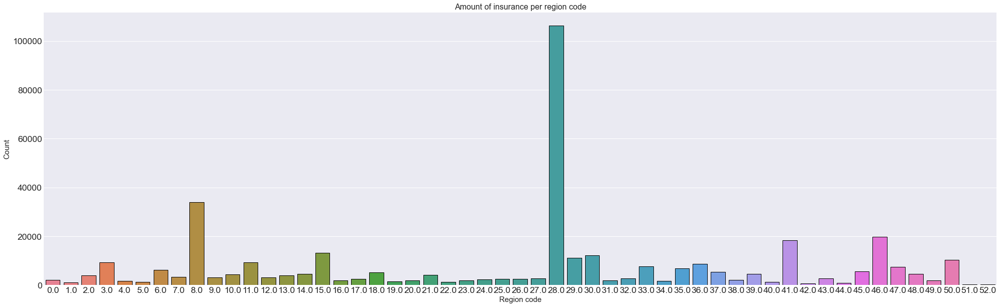

In [71]:
print("H2: The region codes have similar amount of insurance acceptance --> FALSE")


plt.figure(figsize=(34,10))

sns.countplot(x="Region_Code" , data = train, palette ="husl" ,edgecolor="black")
plt.ylabel('Count', fontsize=15)
plt.xlabel('Region code', fontsize=15)
plt.title('Amount of insurance per region code', fontsize=16)
plt.show()

___

# H3

In [72]:
higuest_10_percent = int(round(train.shape[0]*0.1, 1))

In [73]:
higuest_10_percent_premium = train.nlargest(higuest_10_percent, 'Annual_Premium')

H3: People with the highest annual premium values tend to accept new insurance (monthly income and more expensive goods --> FALSE


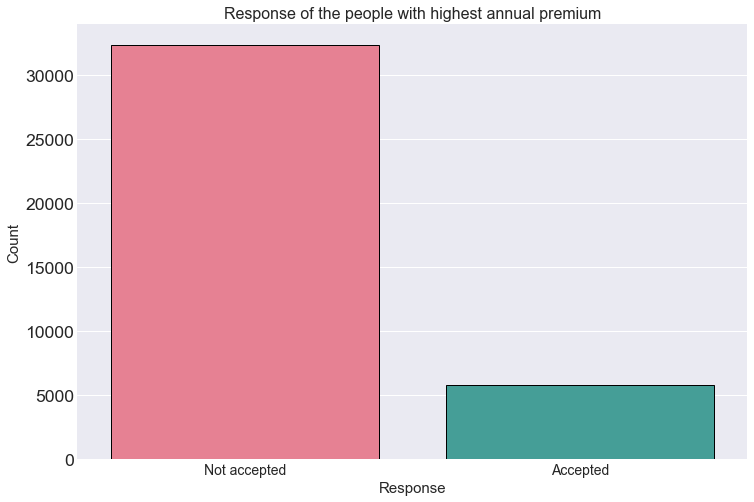

In [74]:
print("H3: People with the highest annual premium values tend to accept new insurance (monthly income and more expensive goods --> FALSE")

plt.figure(figsize=(12,8))

# sets plot features
sns.countplot(x="Response", data = higuest_10_percent_premium, palette ="husl" , edgecolor="black")
plt.ylabel('Count', fontsize=15)
plt.xlabel('Response', fontsize=15)
plt.title('Response of the people with highest annual premium', fontsize=16)
plt.xticks(ticks=[0,1], labels=['Not accepted', 'Accepted'], fontsize=14)

# displays the plot
plt.show()

### Additional information

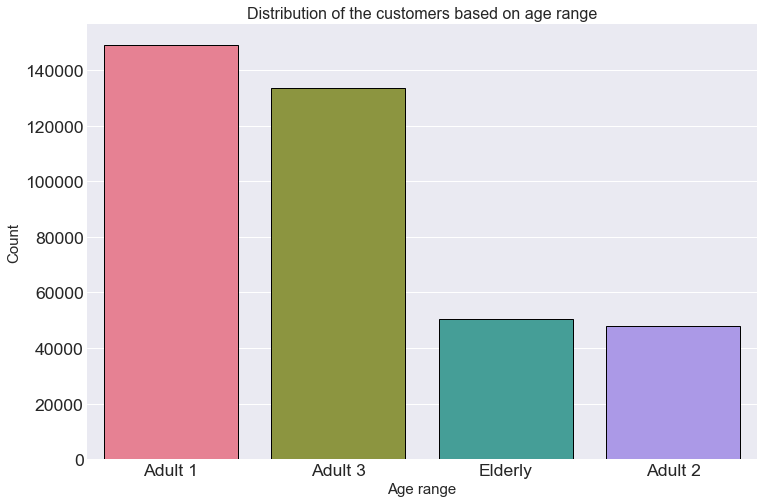

In [75]:
# sets plot features
plt.figure(figsize=(12,8))

sns.countplot(x="age_range", data = train, order = train['age_range'].value_counts().index, palette ="husl" , edgecolor="black")
plt.ylabel('Count', fontsize=15)
plt.xlabel('Age range', fontsize=15)
plt.title("Distribution of the customers based on age range", fontsize=16)
plt.xticks()


# displays the plot
plt.show()

___

# H4

H4: Young people tend to accept the car insurance due to their age --> FALSE


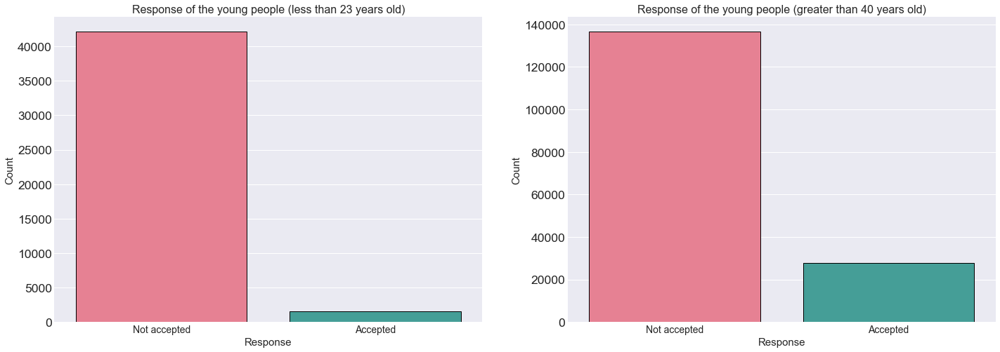

In [76]:
print('H4: Young people tend to accept the car insurance due to their age --> FALSE')

plt.figure(figsize=(24,8))


# sets plot features
plt.subplot(1,2,1)
sns.countplot(x="Response", data = train[train['Age']<23], palette ="husl" , edgecolor="black")
plt.ylabel('Count', fontsize=15)
plt.xlabel('Response', fontsize=15)
plt.title('Response of the young people (less than 23 years old)', fontsize=16)
plt.xticks(ticks=[0,1], labels=['Not accepted', 'Accepted'], fontsize=14)

# sets plot features
plt.subplot(1,2,2)
sns.countplot(x="Response", data = train[train['Age']>40], palette ="husl" , edgecolor="black")
plt.ylabel('Count', fontsize=15)
plt.xlabel('Response', fontsize=15)
plt.title('Response of the young people (greater than 40 years old)', fontsize=16)
plt.xticks(ticks=[0,1], labels=['Not accepted', 'Accepted'], fontsize=14)

# displays the plot
plt.show()

___

# H5

In [77]:
# Number of people who have a driver's license or not

train['Driving_License'].value_counts()

1    380297
0       812
Name: Driving_License, dtype: int64

H5: Only people with driver's license accept car insurance --> FALSE


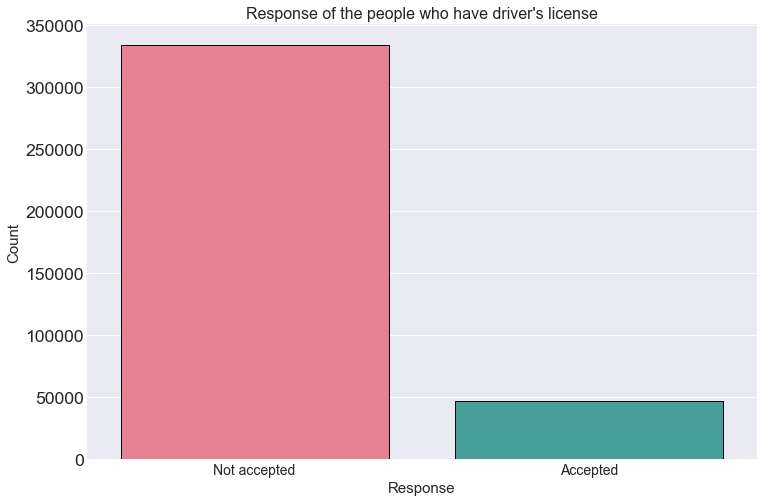

In [78]:
print("H5: Only people with driver's license accept car insurance --> FALSE")

# sets plot features
plt.figure(figsize=(12,8))

sns.countplot(x="Response", data = train[train['Driving_License']==1], palette ="husl" , edgecolor="black")
plt.ylabel('Count', fontsize=15)
plt.xlabel('Response', fontsize=15)
plt.title("Response of the people who have driver's license", fontsize=16)
plt.xticks(ticks=[0,1], labels=['Not accepted', 'Accepted'], fontsize=14)


# displays the plot
plt.show()

___

# H6

H6: People with newer cars are more likely to accept car insurance --> TRUE


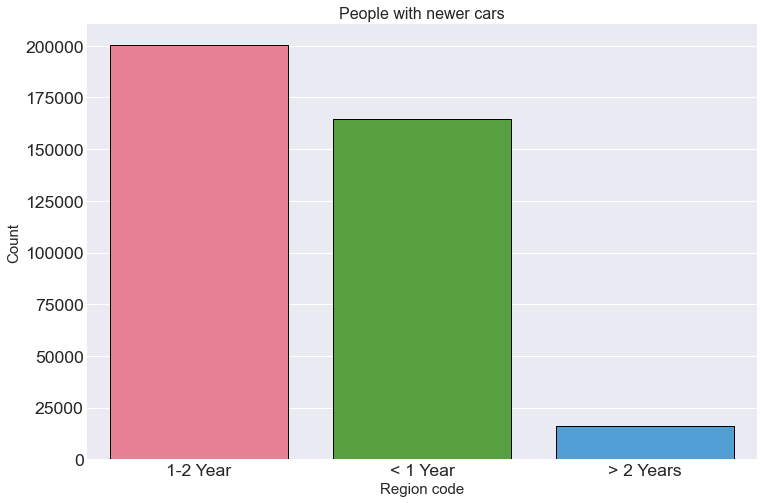

In [79]:
print("H6: People with newer cars are more likely to accept car insurance --> TRUE")
plt.figure(figsize=(12,8))

sns.countplot(x="Vehicle_Age" , data = train, order = train['Vehicle_Age'].value_counts().index, palette ="husl" ,edgecolor="black")
plt.ylabel('Count', fontsize=15)
plt.xlabel('Region code', fontsize=15)
plt.title('People with newer cars', fontsize=16)
plt.show()

___

### Additional information

In [80]:
train[train['insured_with_no_damage']==1]['Response'].value_counts()

0    164634
1        72
Name: Response, dtype: int64

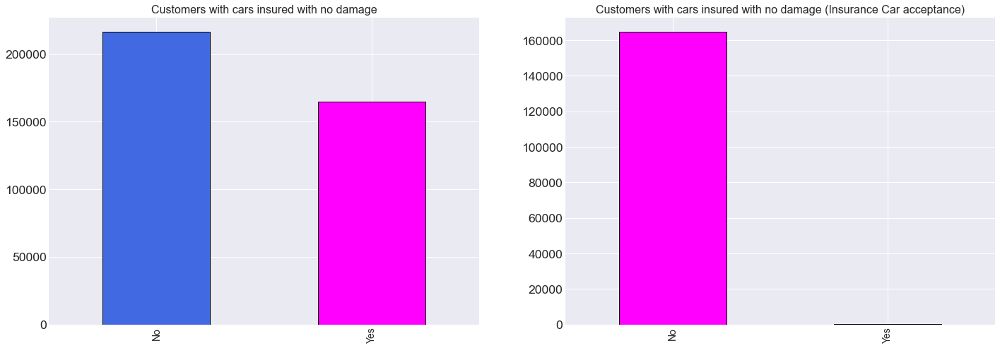

In [81]:
plt.figure(figsize=(24,8))

plt.subplot(1,2,1)
train['insured_with_no_damage'].value_counts().plot(kind='bar',color=['royalblue','magenta'], edgecolor='black')
plt.xticks(ticks=[0,1], labels=['No', 'Yes'], fontsize=14)
plt.title('Customers with cars insured with no damage', fontsize=16)

plt.subplot(1,2,2)
train[train['insured_with_no_damage']==1]['Response'].value_counts().plot(kind='bar', color='magenta', edgecolor='black')
plt.xticks(ticks=[0,1], labels=['No', 'Yes'], fontsize=14)
plt.title('Customers with cars insured with no damage (Insurance Car acceptance)', fontsize=16)

plt.show()

___

## H7

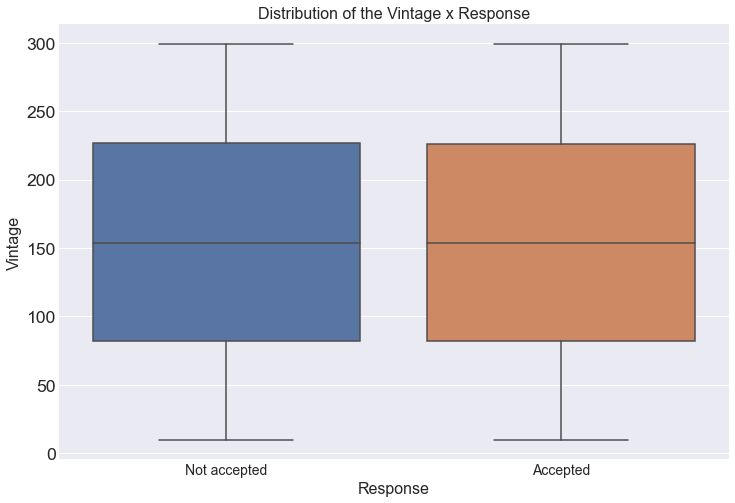

In [82]:
plt.figure(figsize=(12,8))

boxplot(df=train, x='Response', y='Vintage')
plt.xlabel('Response')
plt.ylabel('Vintage')
plt.title('Distribution of the Vintage x Response', fontsize=16)
plt.xticks(ticks=[0,1], labels=['Not accepted', 'Accepted'], fontsize=14)
plt.show()

H07: The customers with the highest vintage values tend to accept the car insurance --> FALSE


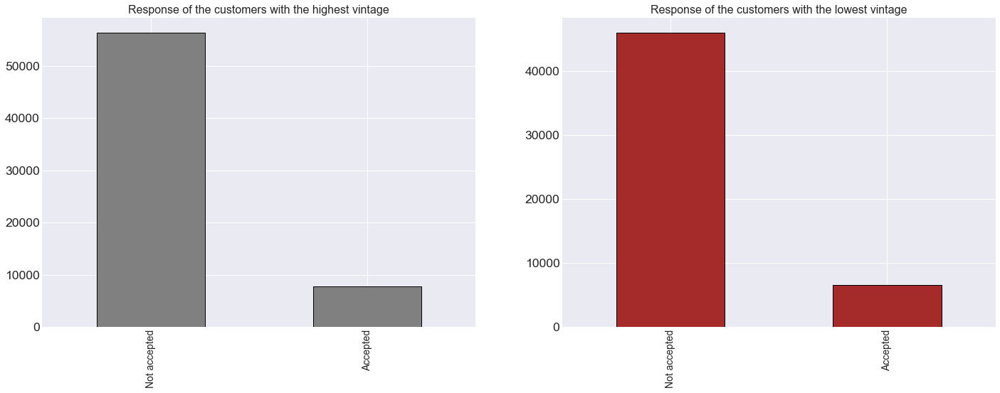

In [83]:
print("H07: The customers with the highest vintage values tend to accept the car insurance --> FALSE")

plt.figure(figsize=(24,8))

plt.subplot(1,2,1)
train[train['Vintage']>250]['Response'].value_counts().plot(kind='bar', color='gray', edgecolor='black')
plt.title('Response of the customers with the highest vintage', fontsize=16)
plt.xticks(ticks=[0,1], labels=['Not accepted', 'Accepted'], fontsize=14)

plt.subplot(1,2,2)
train[train['Vintage']<50]['Response'].value_counts().plot(kind='bar', color='brown', edgecolor='black')
plt.title('Response of the customers with the lowest vintage', fontsize=16)
plt.xticks(ticks=[0,1], labels=['Not accepted', 'Accepted'], fontsize=14)

plt.show()

### The customers with the highest and lowest vintage values have similar behaviour

___

## H8

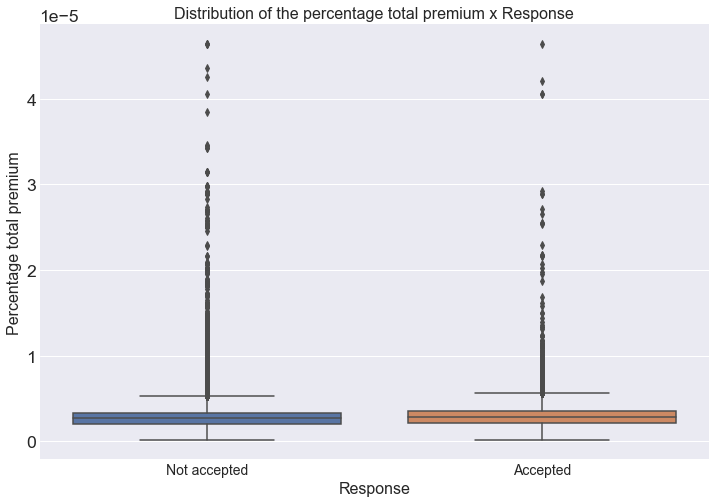

In [84]:
plt.figure(figsize=(12,8))

boxplot(df=train, x='Response', y='percentage_total_premium')
plt.xlabel('Response')
plt.ylabel('Percentage total premium')
plt.title('Distribution of the percentage total premium x Response', fontsize=16)
plt.xticks(ticks=[0,1], labels=['Not accepted', 'Accepted'], fontsize=14)
plt.show()

H08: Customers with the highest percent of total premium tend to increase this value, which means, they will accept the car insurance --> FALSE


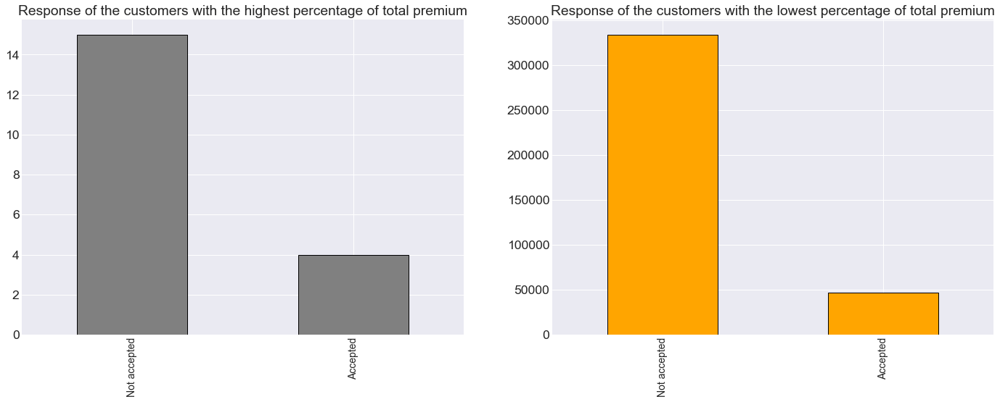

In [85]:
print("H08: Customers with the highest percent of total premium tend to increase this value, which means, they will accept the car insurance --> FALSE")


plt.figure(figsize=(24,8))

plt.subplot(1,2,1)
train[train['percentage_total_premium']>3e-5]['Response'].value_counts().plot(kind='bar', color='gray', edgecolor='black')
plt.title('Response of the customers with the highest percentage of total premium')
plt.xticks(ticks=[0,1], labels=['Not accepted', 'Accepted'], fontsize=14)


plt.subplot(1,2,2)
train[train['percentage_total_premium']<1e-5]['Response'].value_counts().plot(kind='bar', color='orange', edgecolor='black')
plt.title('Response of the customers with the lowest percentage of total premium')
plt.xticks(ticks=[0,1], labels=['Not accepted', 'Accepted'], fontsize=14)


plt.show()

### The customers with the highest and lowest percentage of the total premium have similar behaviour

___

## H9

In [86]:
train[train['Vehicle_Damage_Yes']==1]['Response'].value_counts()

0    146685
1     45728
Name: Response, dtype: int64

H9: Customers with some damage in their cars tend to accept the car insurance --> TRUE


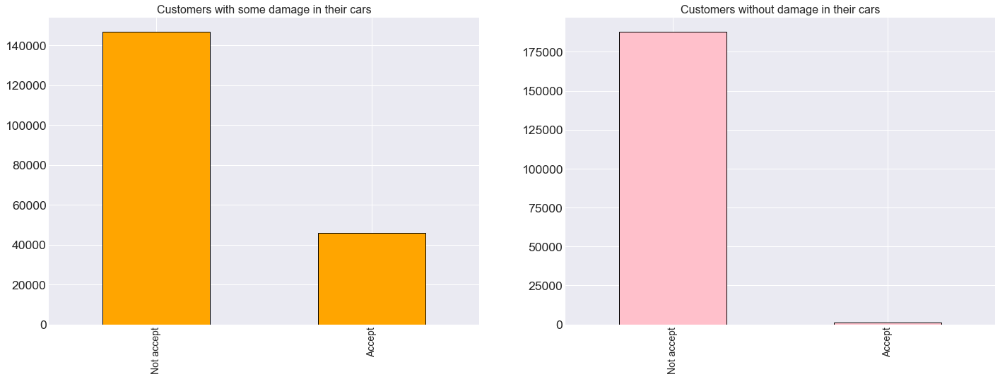

In [87]:
print("H9: Customers with some damage in their cars tend to accept the car insurance --> TRUE")

plt.figure(figsize=(24, 8))

plt.subplot(1,2,1)
train[train['Vehicle_Damage_Yes']==1]['Response'].value_counts().plot(kind='bar', color=['orange'], edgecolor='black')
plt.title('Customers with some damage in their cars', fontsize=16)
plt.xticks(ticks=[0,1], labels=['Not accept', 'Accept'], fontsize=14)

plt.subplot(1,2,2)
train[train['Vehicle_Damage_Yes']==0]['Response'].value_counts().plot(kind='bar', color=['pink'], edgecolor='black')
plt.title('Customers without damage in their cars', fontsize=16)
plt.xticks(ticks=[0,1], labels=['Not accept', 'Accept'], fontsize=14)

plt.show()

___

## H10

In [88]:
train[train['not_insured_with_damage']==1]['Response'].value_counts()

0    136849
1     45642
Name: Response, dtype: int64

H10: If the people have a new car with damage and no insurance, they probably should get insurance --> TRUE


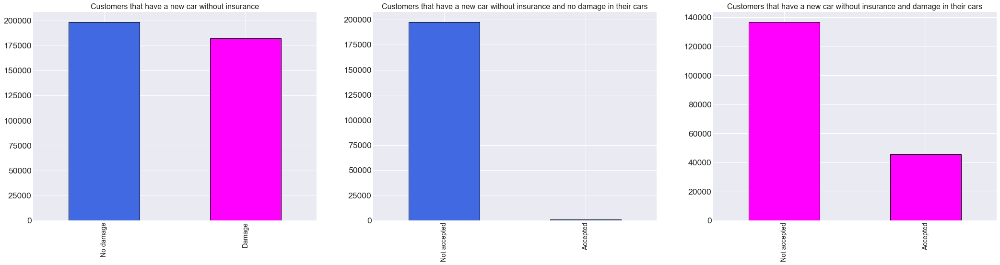

In [89]:
print("H10: If the people have a new car with damage and no insurance, they probably should get insurance --> TRUE")

plt.figure(figsize=(36,8))

plt.subplot(1,3,1)
train['not_insured_with_damage'].value_counts().plot(kind='bar', color=['royalblue','magenta'], edgecolor='black')
plt.title('Customers that have a new car without insurance', fontsize=16)
plt.xticks(ticks=[0,1], labels=['No damage', 'Damage'], fontsize=14)

plt.subplot(1,3,2)
train[train['not_insured_with_damage']==0]['Response'].value_counts().plot(kind='bar', color='royalblue', edgecolor='black')
plt.title('Customers that have a new car without insurance and no damage in their cars', fontsize=16)
plt.xticks(ticks=[0,1], labels=['Not accepted', 'Accepted'], fontsize=14)

plt.subplot(1,3,3)
train[train['not_insured_with_damage']==1]['Response'].value_counts().plot(kind='bar', color='magenta', edgecolor='black')
plt.title("Customers that have a new car without insurance and damage in their cars", fontsize=16)
plt.xticks(ticks=[0,1], labels=['Not accepted', 'Accepted'], fontsize=14)

plt.show()

___

## H11

In [90]:
train[train['insured_with_no_damage']==1]['Response'].value_counts()

0    164634
1        72
Name: Response, dtype: int64

H11: If the customer has insurance and no damage in his car, then the customer tends to not accept the insurance --> TRUE


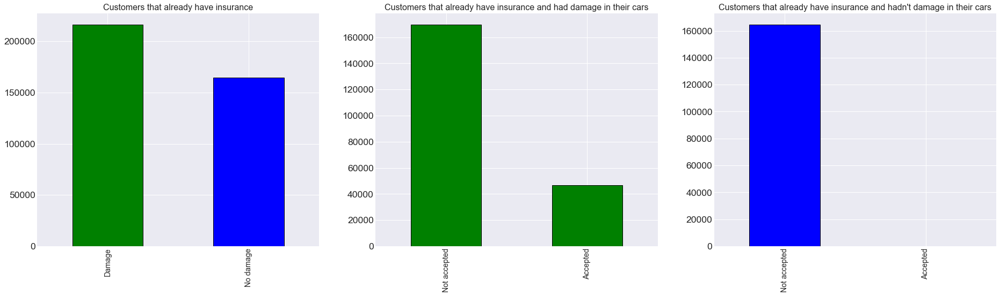

In [91]:
print("H11: If the customer has insurance and no damage in his car, then the customer tends to not accept the insurance --> TRUE")

plt.figure(figsize=(32,8))

plt.subplot(1,3,1)
train['insured_with_no_damage'].value_counts().plot(kind='bar', color=['green','blue'], edgecolor='black')
plt.title('Customers that already have insurance', fontsize=16)
plt.xticks(ticks=[0,1], labels=['Damage', 'No damage'], fontsize=14)

plt.subplot(1,3,2)
train[train['insured_with_no_damage']==0]['Response'].value_counts().plot(kind='bar', color='green', edgecolor='black')
plt.title('Customers that already have insurance and had damage in their cars', fontsize=16)
plt.xticks(ticks=[0,1], labels=['Not accepted', 'Accepted'], fontsize=14)

plt.subplot(1,3,3)
train[train['insured_with_no_damage']==1]['Response'].value_counts().plot(kind='bar', color='blue', edgecolor='black')
plt.title("Customers that already have insurance and hadn't damage in their cars", fontsize=16)
plt.xticks(ticks=[0,1], labels=['Not accepted', 'Accepted'], fontsize=14)

plt.show()

## Summary Hypothesis list

- **H1**: The men are more likely to accept insurance car --> FALSE
- **H2**: The region codes have similar amount of insurance acceptance --> FALSE
- **H3**: People with the highest annual premium values tend to accept new insurance (monthly income and more expensive goods) --> FALSE
- **H4**: Young people tend to accept the car insurance due to their age --> FALSE
- **H5**: Only people with driver's license accept car insurance --> FALSE
- **H6**: People with newer cars are more likely to accept car insurance --> TRUE
- **H7**: The customers with the highest vintage values tend to accept the car insurance --> FALSE
- **H8**: Customers with the highest percent of total premium tend to increase this value, which means, they will accept the car insurance --> FALSE
- **H9**: Customers with some damage in their cars tend to accept the car insurance --> TRUE
- **H10**: If the people have a new car with damage and no insurance, they probably should get insurance --> TRUE
- **H11**: If the customer has insurance and no damage in his car, then the customer tends to not accept the insurance --> TRUE

In [92]:
categorical_features = train.select_dtypes(exclude=[np.number])
numerical_features = train.select_dtypes(include=[np.number])

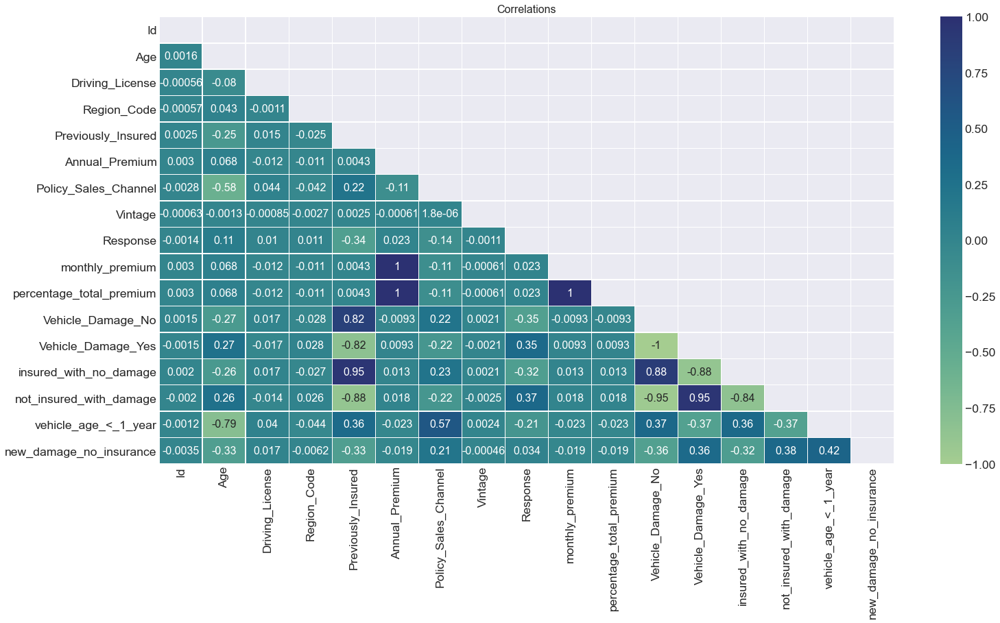

In [93]:
# calculates the correlations
correlations = numerical_features.corr(method='pearson')

# uses the variable ax for single a Axes
fig, ax = plt.subplots()

# sets the figure size in inches
ax.figure.set_size_inches(24, 12)

# generates a mask for the upper triangle
mask = np.triu(np.ones_like(correlations, dtype=np.bool))

# generates a custom diverging colormap
cmap = sns.diverging_palette(220, 10, as_cmap=True)

# plots the heatmap
sns.heatmap(correlations, cmap="crest", mask=mask, linewidths=.5, annot=True)
plt.title('Correlations', fontsize=16)

# displays the plot
plt.show()